In [1]:
#!pip install pycaret[full]
#!pip install explainerdashboard
#!pip install --upgrade fairlearn==0.7.0 raiwidgets
#!pip install scikit-learn==0.23.2

# Data Import

## Import Modules

In [2]:
import os
from pathlib import Path
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pycaret.classification import *

## Set Paths

In [3]:
# set paths
ROOTDIR = os.getcwd()
DATAPATH = os.path.join(ROOTDIR, "data")
Path(DATAPATH).mkdir(parents=True, exist_ok=True)

## Import Customer Churn Dataset

In [4]:
# import data
filename = 'telco_customer_churn.csv'
df = pd.read_csv(os.path.join(DATAPATH, filename))
df.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes


In [5]:
# chech data types
df.dtypes

customerID           object
gender               object
SeniorCitizen         int64
Partner              object
Dependents           object
tenure                int64
PhoneService         object
MultipleLines        object
InternetService      object
OnlineSecurity       object
OnlineBackup         object
DeviceProtection     object
TechSupport          object
StreamingTV          object
StreamingMovies      object
Contract             object
PaperlessBilling     object
PaymentMethod        object
MonthlyCharges      float64
TotalCharges         object
Churn                object
dtype: object

In [6]:
# as we can see TotalCharges should be type float, lets fix this
df['TotalCharges'] = df['TotalCharges'].replace(' ', np.nan)# convert to float64
df['TotalCharges'] = df['TotalCharges'].astype('float64')

In [7]:
# chech data types
df.dtypes

customerID           object
gender               object
SeniorCitizen         int64
Partner              object
Dependents           object
tenure                int64
PhoneService         object
MultipleLines        object
InternetService      object
OnlineSecurity       object
OnlineBackup         object
DeviceProtection     object
TechSupport          object
StreamingTV          object
StreamingMovies      object
Contract             object
PaperlessBilling     object
PaymentMethod        object
MonthlyCharges      float64
TotalCharges        float64
Churn                object
dtype: object

## Check NAs

In [9]:
# check NA values
df.isna().sum()

customerID           0
gender               0
SeniorCitizen        0
Partner              0
Dependents           0
tenure               0
PhoneService         0
MultipleLines        0
InternetService      0
OnlineSecurity       0
OnlineBackup         0
DeviceProtection     0
TechSupport          0
StreamingTV          0
StreamingMovies      0
Contract             0
PaperlessBilling     0
PaymentMethod        0
MonthlyCharges       0
TotalCharges        11
Churn                0
dtype: int64

In [16]:
# replace NA values with the median
median = df['TotalCharges'].median()
df['TotalCharges'] = df['TotalCharges'].replace(np.nan, median)

In [17]:
# check NA values
df.isna().sum()

customerID          0
gender              0
SeniorCitizen       0
Partner             0
Dependents          0
tenure              0
PhoneService        0
MultipleLines       0
InternetService     0
OnlineSecurity      0
OnlineBackup        0
DeviceProtection    0
TechSupport         0
StreamingTV         0
StreamingMovies     0
Contract            0
PaperlessBilling    0
PaymentMethod       0
MonthlyCharges      0
TotalCharges        0
Churn               0
dtype: int64

## Seperate feature into numeric and categorical

In [9]:
# remember which features are numeric and which are categorical
numeric_features = list(df.dtypes[(df.dtypes == 'int64') | (df.dtypes == 'float64')].index)
numeric_features

['SeniorCitizen', 'tenure', 'MonthlyCharges', 'TotalCharges']

In [10]:
categorical_features = list(df.dtypes[df.dtypes == 'object'].index)[1:-1]
categorical_features

['gender',
 'Partner',
 'Dependents',
 'PhoneService',
 'MultipleLines',
 'InternetService',
 'OnlineSecurity',
 'OnlineBackup',
 'DeviceProtection',
 'TechSupport',
 'StreamingTV',
 'StreamingMovies',
 'Contract',
 'PaperlessBilling',
 'PaymentMethod']

# Exploratory Data Analysis

In [11]:
# now that datatypes are correct, lets do some eda
df.describe()

,SeniorCitizen,tenure,MonthlyCharges,TotalCharges
count,7043.000000,7043.000000,7043.000000,7032.000000
mean,0.162147,32.371149,64.761692,2283.300441
std,0.368612,24.559481,30.090047,2266.771362
min,0.000000,0.000000,18.250000,18.800000
25%,0.000000,9.000000,35.500000,401.450000
50%,0.000000,29.000000,70.350000,1397.475000
75%,0.000000,55.000000,89.850000,3794.737500
max,1.000000,72.000000,118.750000,8684.800000


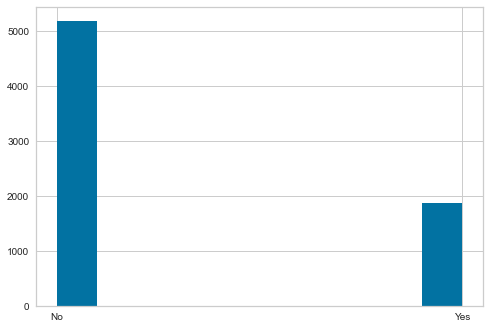

In [12]:
# show target distribution
df['Churn'].hist()
plt.show()

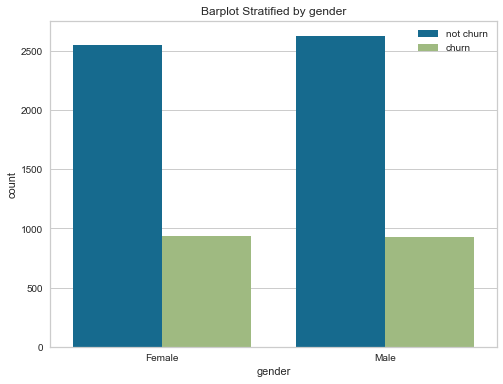

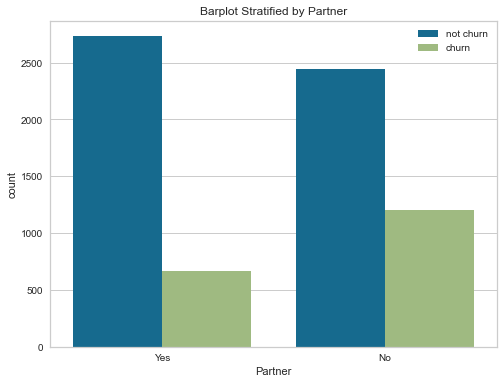

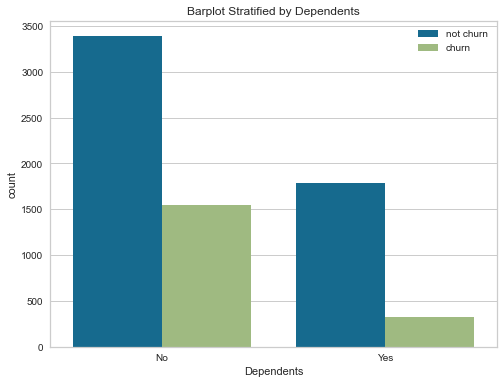

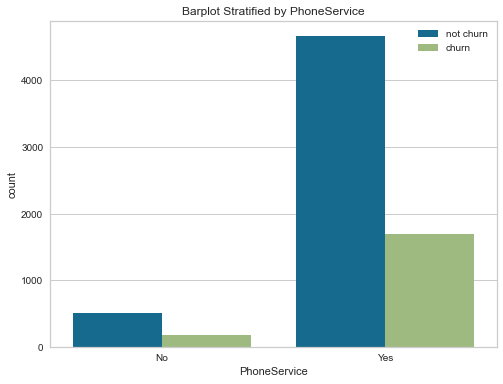

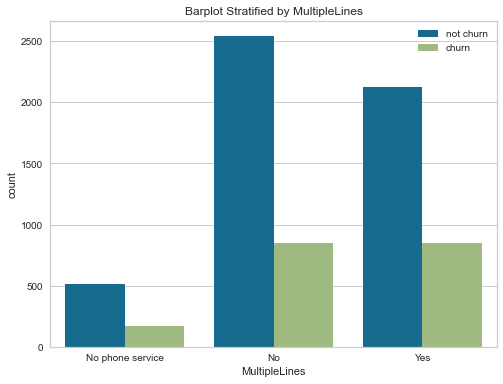

...

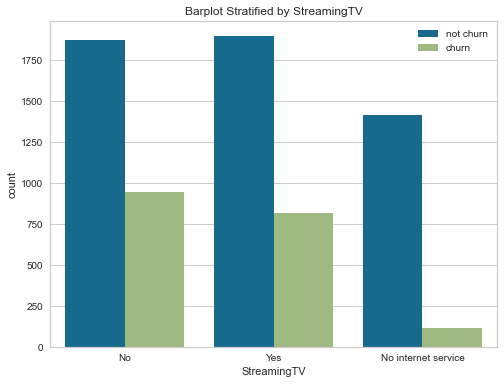

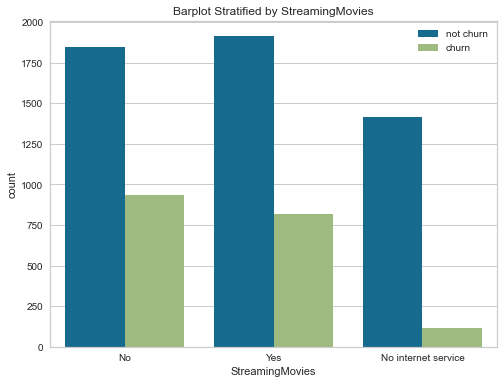

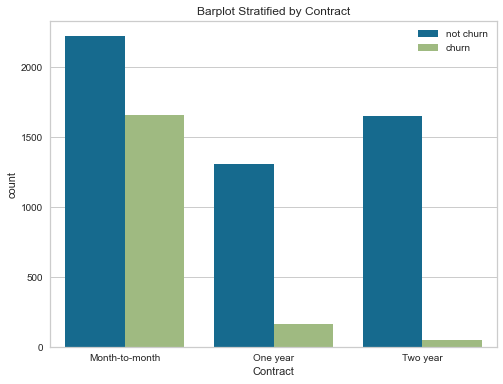

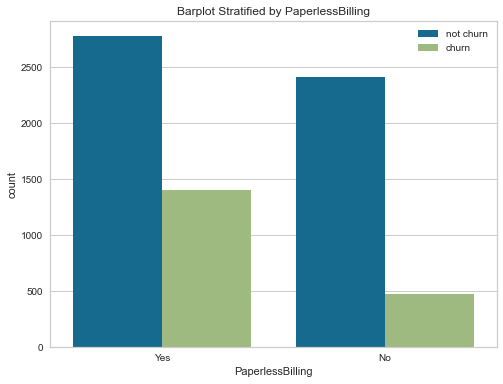

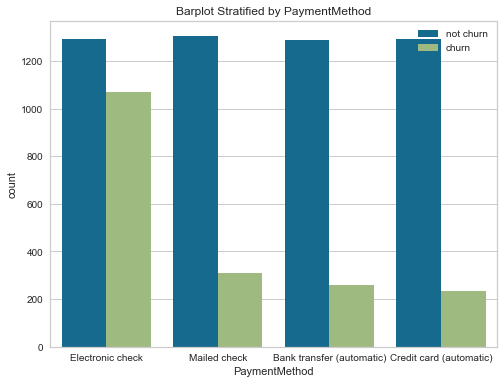

In [13]:
# show distribution of categorical features
for feat in categorical_features:
  fig, ax = plt.subplots(figsize=(8,6))
  ax = sns.countplot(x=feat, hue="Churn", data=df, ax=ax)
  ax.set_title('Barplot Stratified by '+feat)
  ax.legend(['not churn', 'churn'])
  plt.show()

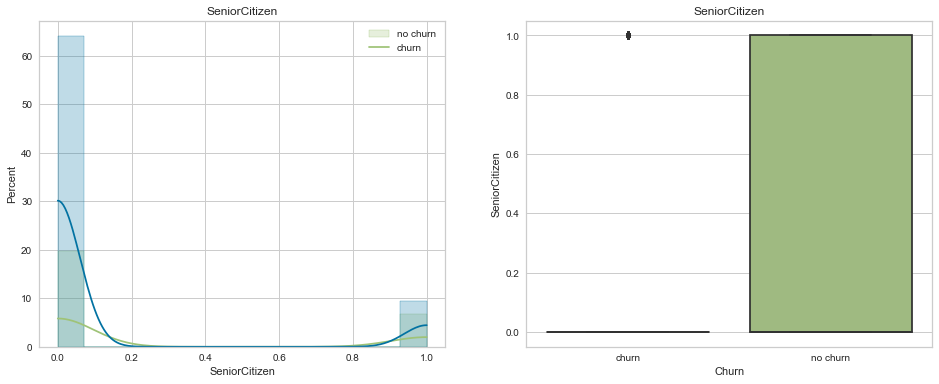

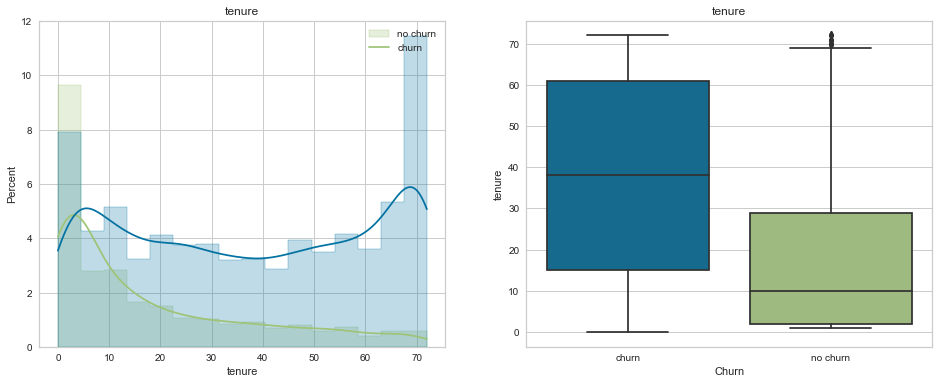

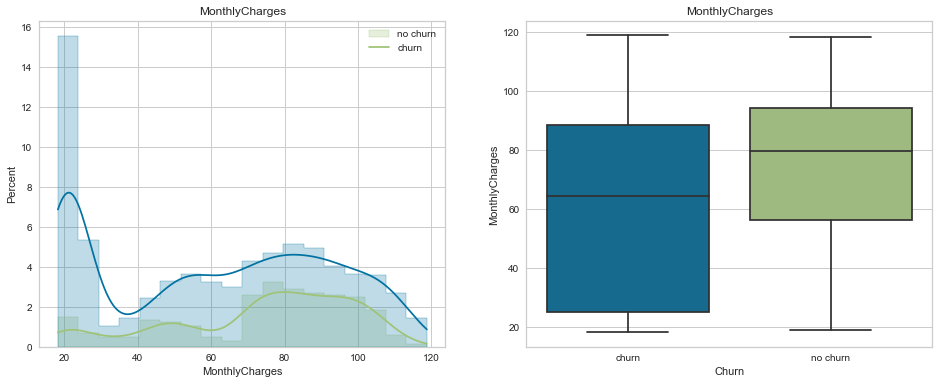

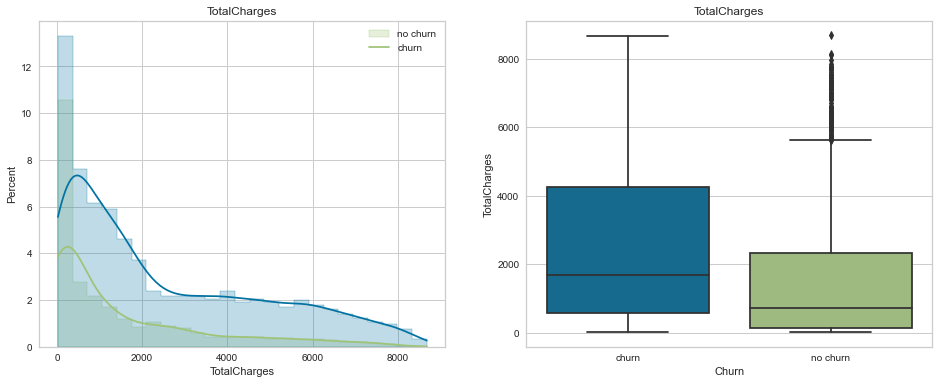

In [14]:
# plot distributions of numeric features
for col in numeric_features:
  try:
    fig, ax = plt.subplots(1,2, figsize=(16,6))
    
    sns.histplot(data=df, 
                 x=col, 
                 hue='Churn', 
                 stat='percent', 
                 kde=True,
                 element='step',
                 ax=ax[0])
    ax[0].set_title(col)
    ax[0].legend(['no churn', 'churn'])

    sns.boxplot(data=df, 
                y=col, 
                x='Churn',
                ax=ax[1])
    ax[1].set_title(col)
    ax[1].set_xticklabels(['churn', 'no churn'])

    plt.show()
  except:
    print('Singular matrix error due to constant feature value')

In [ ]:
# normally, we would save the processed dataset having e.g. imputet missing values etc 
# however, using pycaret for auto-ml, no need to do any manual preprocessing 

# Data Preparation

In [15]:
# the pycaret package does all the data prep behind the scenes
s = setup(df, 
          target='Churn', 
          ignore_features=['customerID'],
          data_split_stratify=True,
          train_size=0.6,
          fold=5,
          log_experiment=True,
          experiment_name='churn_prediction',
          silent=True)

,Description,Value
0,session_id,5490
1,Target,Churn
2,Target Type,Binary
3,Label Encoded,"No: 0, Yes: 1"
4,Original Data,"(7043, 21)"
5,Missing Values,True
6,Numeric Features,3
7,Categorical Features,16
8,Ordinal Features,False
9,High Cardinality Features,False


2022/06/13 11:51:44 INFO mlflow.tracking.fluent: Experiment with name 'churn_prediction' does not exist. Creating a new experiment.


In [16]:
# get training and testing datasets
X = get_config(variable='X')
y = get_config(variable='y')
X_train = get_config(variable='X_train')
y_train = get_config(variable='y_train')
X_test = get_config(variable='X_test')
y_test = get_config(variable='y_test')

In [17]:
X.shape, y.shape, X_train.shape, y_train.shape, X_test.shape, y_test.shape

((7043, 33), (7043,), (4225, 33), (4225,), (2818, 33), (2818,))

In [18]:
X_train.head()

,tenure,MonthlyCharges,TotalCharges,gender_Female,SeniorCitizen_0,Partner_Yes,Dependents_Yes,PhoneService_Yes,MultipleLines_No,MultipleLines_Yes,...,StreamingMovies_No,StreamingMovies_Yes,Contract_Month-to-month,Contract_One year,Contract_Two year,PaperlessBilling_Yes,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check
3820,72.0,112.900002,8061.500000,0.0,0.0,1.0,0.0,1.0,0.0,1.0,...,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
713,14.0,86.000000,1164.050049,1.0,1.0,0.0,1.0,1.0,0.0,1.0,...,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
3618,47.0,54.250000,2538.199951,0.0,1.0,1.0,1.0,1.0,0.0,1.0,...,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
432,2.0,53.450001,119.500000,0.0,1.0,0.0,0.0,1.0,1.0,0.0,...,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2197,66.0,63.849998,4264.600098,0.0,1.0,1.0,0.0,1.0,0.0,1.0,...,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


# Generate Automated Exploratory Data Analysis Using PyCaret

Alert! from version 0.1.39, fter importing, you must do '%matplotlib inline' to display charts in Jupyter Notebooks.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Updated: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.
      chart_format='html' silently saves charts HTML format - they are also interactive!


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
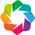

Shape of your Data Set loaded: (7043, 21)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    20 Predictors classified...
        1 variables removed since they were ID or low-information variables

################ Binary_Classification problem #####################


Row
    [0] WidgetBox
        [0] Select(name='y', options=['MonthlyCharges', ...], value='MonthlyCharges')
    [1] ParamFunction(function)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['MonthlyCharges', ...], value='MonthlyCharges')
        [1] Select(name='Y-Axis', options=['MonthlyCharges', ...], value='TotalCharges')
        [2] Select(name='Color', options=['None', 'Churn'], value='None')
    [1] ParamFunction(function)

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['MultipleLines', ...], value='MultipleLines', width=250)
            [1] VSpacer()

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['MonthlyCharges', ...], value='MonthlyCharges', width=250)
            [1] VSpacer()

HoloViews(DynamicMap)

HoloViews(Layout)

HoloViews(Overlay)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['MultipleLines', ...], value='MultipleLines')
        [1] Select(name='Y-Axis', options=['MonthlyCharges', ...], value='MonthlyCharges')
    [1] ParamFunction(function)

Time to run AutoViz (in seconds) = 7


In [19]:
# generate EDA
eda()

# Data Modeling

In [20]:
# compare many models using the AUC as metric assessed via cross validation
best_model = compare_models(sort='AUC')

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lr,Logistic Regression,0.8040,0.8355,0.5415,0.6596,0.5945,0.4670,0.4711,2.2180
gbc,Gradient Boosting Classifier,0.7953,0.8351,0.4871,0.6547,0.5581,0.4286,0.4369,0.2500
ada,Ada Boost Classifier,0.7931,0.8347,0.5183,0.6366,0.5709,0.4365,0.4409,0.1200
lda,Linear Discriminant Analysis,0.7950,0.8292,0.5478,0.6318,0.5864,0.4512,0.4534,0.0240
catboost,CatBoost Classifier,0.7922,0.8265,0.4960,0.6407,0.5588,0.4258,0.4320,2.8780
nb,Naive Bayes,0.7323,0.8229,0.7725,0.4982,0.6053,0.4171,0.4404,0.0120
lightgbm,Light Gradient Boosting Machine,0.7834,0.8168,0.5013,0.6130,0.5513,0.4105,0.4143,0.0920
rf,Random Forest Classifier,0.7813,0.8072,0.4719,0.6149,0.5338,0.3942,0.4002,0.2320
xgboost,Extreme Gradient Boosting,0.7737,0.8035,0.4808,0.5921,0.5302,0.3833,0.3872,0.4360
et,Extra Trees Classifier,0.7669,0.7844,0.4657,0.5753,0.5145,0.3634,0.3670,0.2720


In [21]:
# print best_model parameters
print(best_model)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=5490, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)


In [22]:
# tune best model
tuned_best_model = tune_model(best_model)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.7870,0.8232,0.5580,0.6068,0.5814,0.4389,0.4396
1,0.7964,0.8398,0.5045,0.6494,0.5678,0.4374,0.4434
2,0.8059,0.8453,0.5357,0.6667,0.5941,0.4685,0.4733
3,0.8213,0.8430,0.5759,0.6973,0.6308,0.5143,0.5184
4,0.8024,0.8315,0.5244,0.6629,0.5856,0.4582,0.4636
Mean,0.8026,0.8365,0.5397,0.6566,0.5919,0.4635,0.4677
Std,0.0113,0.0081,0.0250,0.0294,0.0212,0.0280,0.0283


In [23]:
# notice that the AUC has clearly increased from 0.81 to 0.84!

# Model Evaluation

In [24]:
# AUC Plot
plot_model(tuned_best_model, plot = 'auc')

In [25]:
#plot_model(tuned_best_model, plot='rfe')

In [26]:
# Feature Importance Plot
plot_model(tuned_best_model, plot = 'feature')

In [27]:
# Confusion Matrix
plot_model(tuned_best_model, plot = 'confusion_matrix')

# Adding a Custom Business Metric

In [28]:
# create a custom function
def calculate_profit(y, y_pred):
    tp = np.where((y_pred==1) & (y==1), (5000-1000), 0) # a true leads to a net profit of 4000
    fp = np.where((y_pred==1) & (y==0), -1000, 0) # a false positive leads to a net profit of -1000
    return np.sum([tp,fp])# add metric to PyCaret

add_metric('profit', 'Profit', calculate_profit)

Name                                                            Profit
Display Name                                                    Profit
Score Function       <function calculate_profit at 0x000002BED4F838B0>
Scorer                                   make_scorer(calculate_profit)
Target                                                            pred
Args                                                                {}
Greater is Better                                                 True
Multiclass                                                        True
Custom                                                            True
Name: profit, dtype: object

In [29]:
# compare all models
best_business_models = compare_models(sort='Profit', n_select=6)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Profit,TT (Sec)
nb,Naive Bayes,0.7323,0.8229,0.7725,0.4982,0.6053,0.4171,0.4404,517600.0000,0.0160
lr,Logistic Regression,0.8040,0.8355,0.5415,0.6596,0.5945,0.4670,0.4711,422800.0000,0.1040
lda,Linear Discriminant Analysis,0.7950,0.8292,0.5478,0.6318,0.5864,0.4512,0.4534,419400.0000,0.0360
ada,Ada Boost Classifier,0.7931,0.8347,0.5183,0.6366,0.5709,0.4365,0.4409,398000.0000,0.1420
ridge,Ridge Classifier,0.8000,0.0000,0.5049,0.6624,0.5725,0.4451,0.4524,394800.0000,0.0200
catboost,CatBoost Classifier,0.7922,0.8265,0.4960,0.6407,0.5588,0.4258,0.4320,382200.0000,3.7420
gbc,Gradient Boosting Classifier,0.7953,0.8351,0.4871,0.6547,0.5581,0.4286,0.4369,378800.0000,0.3440
lightgbm,Light Gradient Boosting Machine,0.7834,0.8168,0.5013,0.6130,0.5513,0.4105,0.4143,378400.0000,0.1460
rf,Random Forest Classifier,0.7813,0.8072,0.4719,0.6149,0.5338,0.3942,0.4002,356800.0000,0.3300
xgboost,Extreme Gradient Boosting,0.7737,0.8035,0.4808,0.5921,0.5302,0.3833,0.3872,356400.0000,0.4480


In [30]:
# confusion matrix
plot_model(best_business_models[0], plot = 'confusion_matrix')

In [31]:
# Notice that a new column Profit is added this time and surprisingly Naive Bayes 
# which is a pretty bad model in terms of AUC is the best model when it comes to profit.
# However, using the custom business metric, we increased the profit by 90.000 ($) on the testset
# Let´s calculate the profit on the whole dataset

In [32]:
best_business_models

[GaussianNB(priors=None, var_smoothing=1e-09),
 LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                    intercept_scaling=1, l1_ratio=None, max_iter=1000,
                    multi_class='auto', n_jobs=None, penalty='l2',
                    random_state=5490, solver='lbfgs', tol=0.0001, verbose=0,
                    warm_start=False),
 LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                            solver='svd', store_covariance=False, tol=0.0001),
 AdaBoostClassifier(algorithm='SAMME.R', base_estimator=None, learning_rate=1.0,
                    n_estimators=50, random_state=5490),
 RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                 max_iter=None, normalize=False, random_state=5490,
                 solver='auto', tol=0.001),

In [33]:
# compare the former AUC optimized model i.e. logistic_regression vs the optimal profit optimized model i.e. naive baies

logistic_reg_model = best_business_models[2] # AUC optimized
gaussian_nb_model = best_business_models[0] # profit optimized

# using auc model
y_pred = logistic_reg_model.predict(X)
profit_auc_model = calculate_profit(y, y_pred)
print('Using the AUC optimized model yield a profit of {} dollar.'.format(profit_auc_model))

# using profit model
y_pred = gaussian_nb_model.predict(X)
profit_business_model = calculate_profit(y, y_pred)
print('Using the profit optimized model yield a profit of {} dollar.'.format(profit_business_model))

print('Hence, the business model increased the profit by {} dollar'.format(profit_business_model - profit_auc_model))

Using the AUC optimized model yield a profit of 3582000 dollar.
Using the profit optimized model yield a profit of 4466000 dollar.
Hence, the business model increased the profit by 884000 dollar


In [34]:
#plot_model(profit_business_model, plot = 'class_report')

# Model Explainability Dashboard

In [35]:
from explainerdashboard import ClassifierExplainer, ExplainerDashboard
import shap

In [36]:
# fit a tree model for increased speed when explaining the model
model = create_model('gbc')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Profit
Fold,,,,,,,,
0,0.7799,0.8150,0.5045,0.6011,0.5485,0.4045,0.4072,377000.0000
1,0.8059,0.8508,0.4955,0.6852,0.5751,0.4535,0.4635,393000.0000
2,0.7929,0.8425,0.4598,0.6561,0.5407,0.4123,0.4231,358000.0000
3,0.7988,0.8350,0.4866,0.6646,0.5619,0.4353,0.4442,381000.0000
4,0.7988,0.8324,0.4889,0.6667,0.5641,0.4373,0.4462,385000.0000
Mean,0.7953,0.8351,0.4871,0.6547,0.5581,0.4286,0.4369,378800.0000
Std,0.0087,0.0119,0.0150,0.0285,0.0121,0.0178,0.0196,11668.7617


In [37]:
explainer = ClassifierExplainer(model, X_test, y_test, X_background=shap.sample(X, 50))

Generating self.shap_explainer = shap.TreeExplainer(model, X_background, model_output='probability', feature_perturbation='interventional')...
Note: Shap interaction values will not be available. If shap values in probability space are not necessary you can pass model_output='logodds' to get shap values in logodds without the need for a background dataset and also working shap interaction values...


In [38]:
ExplainerDashboard(explainer).run()

Building ExplainerDashboard..
Detected notebook environment, consider setting mode='external', mode='inline' or mode='jupyterlab' to keep the notebook interactive while the dashboard is running...
For this type of model and model_output interactions don't work, so setting shap_interaction=False...
The explainer object has no decision_trees property. so setting decision_trees=False...
Generating layout...
Calculating shap values...
Calculating prediction probabilities...
Calculating metrics...
Calculating confusion matrices...
Calculating classification_dfs...
Calculating roc auc curves...
Calculating pr auc curves...
Calculating liftcurve_dfs...
Calculating dependencies...
Calculating permutation importances (if slow, try setting n_jobs parameter)...
Calculating pred_percentiles...
Calculating predictions...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExplainer.from_file('explainer.jobl

 * Running on all addresses.
 * Running on http://192.168.1.234:8050/ (Press CTRL+C to quit)
192.168.1.234 - - [13/Jun/2022 11:57:20] "GET / HTTP/1.1" 200 -
192.168.1.234 - - [13/Jun/2022 11:57:20] "GET /assets/bootstrap.min.css?m=1651145324.5950305 HTTP/1.1" 200 -
192.168.1.234 - - [13/Jun/2022 11:57:20] "GET /_dash-component-suites/dash/deps/react@16.v2_3_1m1651145278.14.0.min.js HTTP/1.1" 200 -
192.168.1.234 - - [13/Jun/2022 11:57:20] "GET /_dash-component-suites/dash/deps/polyfill@7.v2_3_1m1651145278.12.1.min.js HTTP/1.1" 200 -
192.168.1.234 - - [13/Jun/2022 11:57:20] "GET /_dash-component-suites/dash/deps/prop-types@15.v2_3_1m1651145278.7.2.min.js HTTP/1.1" 200 -
192.168.1.234 - - [13/Jun/2022 11:57:20] "GET /_dash-component-suites/dash/deps/react-dom@16.v2_3_1m1651145278.14.0.min.js HTTP/1.1" 200 -
192.168.1.234 - - [13/Jun/2022 11:57:20] "GET /_dash-component-suites/dash/dcc/dash_core_components-shared.v2_3_0m1651145278.js HTTP/1.1" 200 -
192.168.1.234 - - [13/Jun/2022 11:57:20]

In [39]:
ExplainerDashboard.terminate(8050)

Trying to shut down dashboard on port 8050...
Something seems to have failed: HTTPConnectionPool(host='localhost', port=8050): Max retries exceeded with url: /_shutdown_e0fa992f-3e99-454f-b301-eb75175bf35c (Caused by NewConnectionError('<urllib3.connection.HTTPConnection object at 0x000002BED92B0940>: Failed to establish a new connection: [WinError 10061] Es konnte keine Verbindung hergestellt werden, da der Zielcomputer die Verbindung verweigerte'))


# Check Model Fairness

In [40]:
from sklearn.metrics import roc_auc_score, accuracy_score, recall_score, precision_score, f1_score
from fairlearn.metrics import selection_rate, MetricFrame
from fairlearn.reductions import GridSearch, EqualizedOdds, FalsePositiveRateParity
from raiwidgets import FairnessDashboard

In [41]:
# fit a tree model for increased speed when explaining the model
model = create_model('gbc')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Profit
Fold,,,,,,,,
0,0.7799,0.8150,0.5045,0.6011,0.5485,0.4045,0.4072,377000.0000
1,0.8059,0.8508,0.4955,0.6852,0.5751,0.4535,0.4635,393000.0000
2,0.7929,0.8425,0.4598,0.6561,0.5407,0.4123,0.4231,358000.0000
3,0.7988,0.8350,0.4866,0.6646,0.5619,0.4353,0.4442,381000.0000
4,0.7988,0.8324,0.4889,0.6667,0.5641,0.4373,0.4462,385000.0000
Mean,0.7953,0.8351,0.4871,0.6547,0.5581,0.4286,0.4369,378800.0000
Std,0.0087,0.0119,0.0150,0.0285,0.0121,0.0178,0.0196,11668.7617


In [42]:
X_train.columns

Index(['tenure', 'MonthlyCharges', 'TotalCharges', 'gender_Female',
       'SeniorCitizen_0', 'Partner_Yes', 'Dependents_Yes', 'PhoneService_Yes',
       'MultipleLines_No', 'MultipleLines_Yes', 'InternetService_DSL',
       'InternetService_Fiber optic', 'OnlineSecurity_No',
       'OnlineSecurity_Yes', 'OnlineBackup_No',
       'OnlineBackup_No internet service', 'OnlineBackup_Yes',
       'DeviceProtection_No', 'DeviceProtection_Yes', 'TechSupport_No',
       'TechSupport_Yes', 'StreamingTV_No', 'StreamingTV_Yes',
       'StreamingMovies_No', 'StreamingMovies_Yes', 'Contract_Month-to-month',
       'Contract_One year', 'Contract_Two year', 'PaperlessBilling_Yes',
       'PaymentMethod_Bank transfer (automatic)',
       'PaymentMethod_Credit card (automatic)',
       'PaymentMethod_Electronic check', 'PaymentMethod_Mailed check'],
      dtype='object')

In [43]:
# make sensitive feature array for train and test data
if 'gender_Male' in list(X_train.columns):
  # train data
  S_train = X_train[['gender_Male']].copy()
  S_train['gender_Female'] = 1
  S_train['gender_Female'] = S_train['gender_Female'] - S_train['gender_Male']
  S_train.drop('gender_Male', axis=1, inplace=True)

  # test data
  S_test = X_test[['gender_Male']].copy()
  S_test['gender_Female'] = 1
  S_test['gender_Female'] = S_test['gender_Female'] - S_test['gender_Male']
  S_test.drop('gender_Male', axis=1, inplace=True) 
else:
  S_train = X_train[['gender_Female']].copy()
  S_test = X_test[['gender_Female']].copy()   

In [44]:
# Get metrics by sensitive group from fairlearn
print('\nMetrics by Group:')
metrics = {'selection_rate': selection_rate,
           'accuracy': accuracy_score,
           'recall': recall_score,
           'precision': precision_score,
           'f1': f1_score}

group_metrics = MetricFrame(metrics=metrics,
                             y_true=y_test,
                             y_pred=model.predict(X_test),
                             sensitive_features=S_test)

print(group_metrics.by_group)


Metrics by Group:
              selection_rate  accuracy    recall precision        f1
gender_Female                                                       
0.0                 0.213034  0.819201  0.563187  0.674342  0.613772
1.0                 0.212078  0.793674  0.510417  0.664407   0.57732


## Fairness Dashboard

In [45]:
# View this model in Fairlearn's fairness dashboard, and see the disparities which appear:
FairnessDashboard(sensitive_features=S_test,
                   y_true=y_test,
                   y_pred={"churn_model": model.predict(X_test)})

Fairness started at http://localhost:5000


## Mitigate Unfairness in the Model

In [46]:
# Mitigate Selection Parity

print('Finding mitigated models...')

# Train multiple models
sweep = GridSearch(model,
                   constraints=EqualizedOdds(),
                   grid_size=10)

sweep.fit(X_train, y_train, sensitive_features=S_train)
models = sweep.predictors_

Finding mitigated models...


In [47]:
models

[GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                            learning_rate=0.1, loss='deviance', max_depth=3,
                            max_features=None, max_leaf_nodes=None,
                            min_impurity_decrease=0.0, min_impurity_split=None,
                            min_samples_leaf=1, min_samples_split=2,
                            min_weight_fraction_leaf=0.0, n_estimators=100,
                            n_iter_no_change=None, presort='deprecated',
                            random_state=5490, subsample=1.0, tol=0.0001,
                            validation_fraction=0.1, verbose=0,
                            warm_start=False),
 GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                            learning_rate=0.1, loss='deviance', max_depth=3,
                            max_features=None, max_leaf_nodes=None,
                            min_impurity_decrease=0.0, min_impurity

In [48]:
# Compare two different models

# first model
y_pred = models[0].predict(X_test)
group_metrics = MetricFrame(metrics=metrics,
                             y_true=y_test,
                             y_pred=y_pred,
                             sensitive_features=S_test)

print(group_metrics.by_group)

# last model
y_pred = models[-1].predict(X_test)
group_metrics = MetricFrame(metrics=metrics,
                             y_true=y_test,
                             y_pred=y_pred,
                             sensitive_features=S_test)

print(group_metrics.by_group)

              selection_rate  accuracy    recall precision        f1
gender_Female                                                       
0.0                      1.0  0.255081       1.0  0.255081  0.406477
1.0                 0.066858  0.766355  0.197917  0.817204  0.318658
              selection_rate  accuracy    recall precision        f1
gender_Female                                                       
0.0                 0.331465  0.786265  0.730769  0.562368  0.635603
1.0                 0.360173   0.38821  0.044271  0.033932  0.038418


In [49]:
# show model fairness for all models
for model in models:
  y_pred = model.predict(X_test)
  group_metrics = MetricFrame(metrics=metrics,
                              y_true=y_test,
                              y_pred=y_pred,
                              sensitive_features=S_test)

  print('---------------------------------------------\n')
  print('Model Fairness Metrics: ')
  print(group_metrics.by_group)
  print('---------------------------------------------\n')

---------------------------------------------

Model Fairness Metrics: 
              selection_rate  accuracy    recall precision        f1
gender_Female                                                       
0.0                      1.0  0.255081       1.0  0.255081  0.406477
1.0                 0.066858  0.766355  0.197917  0.817204  0.318658
---------------------------------------------

---------------------------------------------

Model Fairness Metrics: 
              selection_rate  accuracy recall precision        f1
gender_Female                                                    
0.0                      1.0  0.255081    1.0  0.255081  0.406477
1.0                      0.0   0.72394    0.0       0.0       0.0
---------------------------------------------

---------------------------------------------

Model Fairness Metrics: 
              selection_rate  accuracy    recall precision        f1
gender_Female                                                       
0.0         

In [50]:
# Get predictions from all models them (plus the original unmitigated one for comparison)
model_name = 'churn_model_unmitigated'
print(model_name)
predictions = {model_name: model.predict(X_test)}
i = 0
for model in models:
    i += 1
    model_name = 'churn_model_mitigated_{0}'.format(i)
    print(model_name)
    predictions[model_name] = model.predict(X_test)

churn_model_unmitigated
churn_model_mitigated_1
churn_model_mitigated_2
churn_model_mitigated_3
churn_model_mitigated_4
churn_model_mitigated_5
churn_model_mitigated_6
churn_model_mitigated_7
churn_model_mitigated_8
churn_model_mitigated_9
churn_model_mitigated_10


In [51]:
FairnessDashboard(sensitive_features=S_test,
                   y_true=y_test,
                   y_pred=predictions)

Fairness started at http://localhost:5001


In [52]:
group_metrics.by_group

,selection_rate,accuracy,recall,precision,f1
gender_Female,,,,,
0.0,0.331465,0.786265,0.730769,0.562368,0.635603
1.0,0.360173,0.38821,0.044271,0.033932,0.038418


In [53]:
print('f1 male: ', group_metrics.by_group.f1[0])
print('f1 female: ', group_metrics.by_group.f1[1])

f1 male:  0.6356033452807647
f1 female:  0.0384180790960452


In [54]:
# show model fairness for all models
model_fairness = {}

# calculate group metric for the unmitigated model
group_metrics = MetricFrame(metrics=metrics,
                            y_true=y_test,
                            y_pred=model.predict(X_test),
                            sensitive_features=S_test)

# get accuracy for females
f1_f = group_metrics.by_group.f1[1]
# get r2 for males
f1_m = group_metrics.by_group.f1[0]
# show the r2 difference between men and women
f1_diff = np.abs(f1_f - f1_m)

# track model performance and faireness
model_fairness['model_unmitigated'] = [f1_f, f1_m, f1_diff]


counter = 0
for model in models:
  counter += 1
  y_pred = model.predict(X_test)
  group_metrics = MetricFrame(metrics=metrics,
                              y_true=y_test,
                              y_pred=y_pred,
                              sensitive_features=S_test)

  # get accuracy for females
  f1_f = group_metrics.by_group.f1[1]
  # get r2 for males
  f1_m = group_metrics.by_group.f1[0]
  # show the r2 difference between men and women
  f1_diff = np.abs(f1_f - f1_m)

  # track model performance and faireness
  model_fairness['model_mitigated #'+str(counter)] = [f1_f, f1_m, f1_diff] 


  print('---------------------------------------------\n')
  print('Model #', counter)
  print('Model Fairness Metrics: ')
  print(group_metrics.by_group)
  print(' F1 Difference Men vs Women: f1-diff={:.2f}'.format(f1_diff))
  print('---------------------------------------------\n')

---------------------------------------------

Model # 1
Model Fairness Metrics: 
              selection_rate  accuracy    recall precision        f1
gender_Female                                                       
0.0                      1.0  0.255081       1.0  0.255081  0.406477
1.0                 0.066858  0.766355  0.197917  0.817204  0.318658
 F1 Difference Men vs Women: f1-diff=0.09
---------------------------------------------

---------------------------------------------

Model # 2
Model Fairness Metrics: 
              selection_rate  accuracy recall precision        f1
gender_Female                                                    
0.0                      1.0  0.255081    1.0  0.255081  0.406477
1.0                      0.0   0.72394    0.0       0.0       0.0
 F1 Difference Men vs Women: f1-diff=0.41
---------------------------------------------

---------------------------------------------

Model # 3
Model Fairness Metrics: 
              selection_rate  accura

In [55]:
# transform fairness and performance dict to dataframe
df_fairness = pd.DataFrame(model_fairness, index=['f1_female', 'f1_male', 'f1_diff']).T
df_fairness.head()

,f1_female,f1_male,f1_diff
model_unmitigated,0.038418,0.635603,0.597185
model_mitigated #1,0.318658,0.406477,0.087819
model_mitigated #2,0.000000,0.406477,0.406477
model_mitigated #3,0.409266,0.406477,0.002790
model_mitigated #4,0.635104,0.043829,0.591275


In [56]:
# add f2 averaged over both groups
df_fairness['f1_group_average'] = 0.5*(df_fairness['f1_female'] + df_fairness['f1_male'])
df_fairness.head()

,f1_female,f1_male,f1_diff,f1_group_average
model_unmitigated,0.038418,0.635603,0.597185,0.337011
model_mitigated #1,0.318658,0.406477,0.087819,0.362568
model_mitigated #2,0.000000,0.406477,0.406477,0.203238
model_mitigated #3,0.409266,0.406477,0.002790,0.407872
model_mitigated #4,0.635104,0.043829,0.591275,0.339467


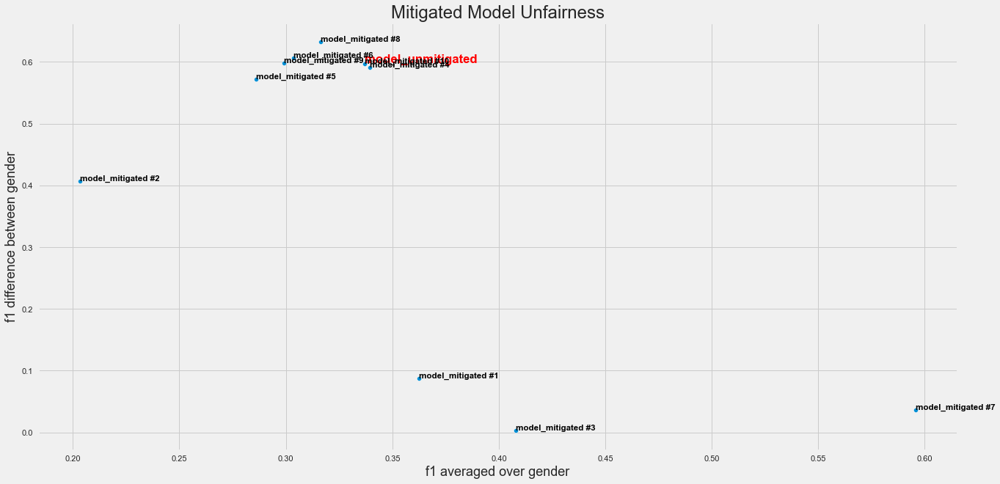

In [57]:
plt.figure(figsize=(20,10))
ax = sns.scatterplot(x='f1_group_average', 
                     y='f1_diff', 
                     data=df_fairness)

# plot unmitigated model
line = 0
ax.text(df_fairness.f1_group_average[line], df_fairness.f1_diff[line]+0.001, 
df_fairness.index[line], horizontalalignment='left', 
size='large', color='red', weight='bold')

# plot mitigated models
for line in range(1, df_fairness.shape[0]):
  ax.text(df_fairness.f1_group_average[line], df_fairness.f1_diff[line]+0.001, 
  df_fairness.index[line], horizontalalignment='left', 
  size='small', color='black', weight='semibold')

ax.set_xlabel('f1 averaged over gender', size=18)
ax.set_ylabel('f1 difference between gender', size=18)
ax.set_title('Mitigated Model Unfairness', size=24)
ax.grid('on')

plt.show()

# Finalize and Save Pipeline

In [58]:
# finalize the model
final_model = finalize_model(tuned_best_model)

In [59]:
# save model to disk
save_model(final_model, 'churn-pipeline')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=False,
                                       features_todrop=['customerID'],
                                       id_columns=[],
                                       ml_usecase='classification',
                                       numerical_features=[], target='Churn',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='not_available',
                                 fill_value_categorical=None,
                                 fill_value_numerical=None,
                                 n...
                 ('feature_select', 'passthrough'), ('fix_multi', 'passthrough'),
                 ('dfs', 'passthrough'), ('pca', 'passthrough'),
                 ['trained_model',
                  LogisticRegression(C=3.433, class_w

# Model Deployment

In [ ]:
# run this on local computer not in colab
#!mlflow ui